# 1) Import libraries and datasets

In [7]:
#Basic Modules
import pandas as pd
import re
import numpy as np
import matplotlib.pyplot as plt
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
from collections import Counter
from wordcloud import WordCloud
from sklearn.cluster import KMeans
from gensim.models import Word2Vec
from sklearn.decomposition import PCA

from textblob import Blobber
from textblob_fr import PatternTagger, PatternAnalyzer
tb = Blobber(pos_tagger=PatternTagger(), analyzer=PatternAnalyzer())

import plotly.express as px
pd.set_option('display.max_columns', None)
pd.set_option('max_colwidth', 1000)

#import jupyterthemes as jt
#!jt -t monokai

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\suvin\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [45]:
data_train = pd.read_csv("C:/Users/suvin/Desktop/NLP/PROJET2/avisassurance_train.csv",sep=';')
print("size of train dataset = ",data_train.shape)
print("size of test dataset = ",data_test.shape)

size of train dataset =  (24105, 6)
size of test dataset =  (10332, 5)


# 2) Data exploration

In [46]:
data_train.head(1)

,date,note,auteur,avis,assureur,produit
0,06 septembre 2021 suite à une expérience en septembre 2021,5,brahim--k-131532,"Meilleurs assurances, prix, solutions, écoute, rapidité, et je recommande cette compagnie pour vous \r\nDes prix attractif et services de qualité et rapidité",Direct Assurance,auto


<AxesSubplot:title={'center':'Repartition des notes dans le dataset'}, ylabel='None'>

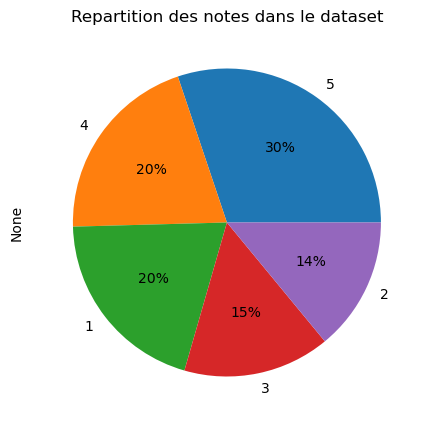

In [47]:
plt.figure(figsize=(10,5))
l = data_train['note'].unique()
data_train.groupby(['note']).size().sort_values(ascending=False).plot(kind='pie',labels=l,autopct='%1.0f%%',title='Repartition des notes dans le dataset')

In [48]:
liste_assureur = data_train.groupby(['assureur']).size().sort_values(ascending=False)
liste_assureur[:5]

assureur
Direct Assurance       5896
L'olivier Assurance    4288
APRIL Moto             1023
GMF                     998
Néoliane Santé          861
dtype: int64

In [49]:
liste_assureur[51:]

assureur
LCL       18
Mapa      10
Sma        6
MMA        4
Hiscox     1
dtype: int64

produit
auto                                     14077
sante                                     3525
moto                                      2105
habitation                                1956
prevoyance                                 791
credit                                     653
vie                                        578
animaux                                    374
multirisque-professionnelle                 20
garantie-decennale                          12
assurances-professionnelles                  8
responsabilite-civile-professionnelle        5
flotte-automobile                            1
dtype: int64


<AxesSubplot:xlabel='produit ', ylabel='Size'>

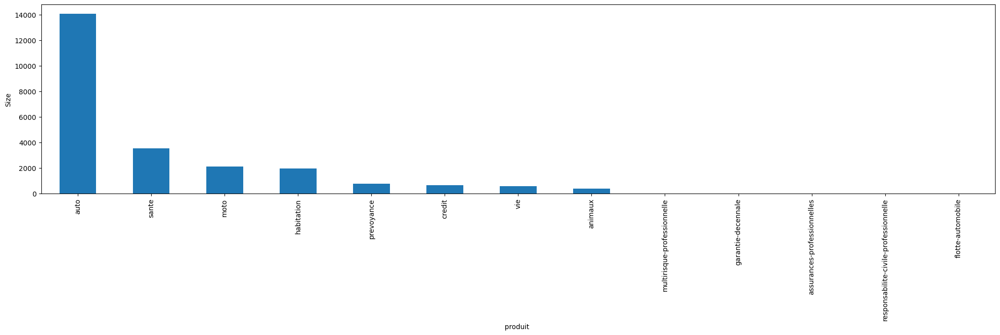

In [50]:
plt.figure(figsize=(25,5))
l2=data_train['produit'].unique()
liste_produit = data_train.groupby(['produit']).size().sort_values(ascending=False)
print(liste_produit)
liste_produit.plot(kind='bar', xlabel='produit ', ylabel = 'Size')

# 3) Pre processing after exploration

In [51]:
for col in data_train.columns:
    zero = (data_train[col].isnull().sum() / len(data_train)) * 100
    zero = round(zero,4)
    print(f'   - {col} : {zero}%')

   - date : 0.0%
   - note : 0.0%
   - auteur : 0.0041%
   - avis : 0.0041%
   - assureur : 0.0%
   - produit : 0.0%


In [52]:
data_train['avis'].fillna('', inplace=True)
data_train['auteur'].fillna('', inplace=True)

In [53]:
def date_format(value): 
    day, month, year = value.lower().strip().split(' ')[:3]
    if month == 'janvier': 
        month = '01'
    elif month == 'février' or month == 'fevrier': 
        month = '02'
    elif month == 'mars': 
        month = '03'
    elif month == 'avril': 
        month = '04'
    elif month == 'mai': 
        month = '05'
    elif month == 'juin': 
        month = '06'
    elif month == 'juillet': 
        month = '07'
    elif month == 'aout' or 'août': 
        month = '08'
    elif month == 'septembre': 
        month = '09'
    elif month == 'octobre': 
        month = '10'
    elif month == 'novembre': 
        month = '11'
    elif month == 'decembre' or 'décembre': 
        month = '12'      
    return pd.to_datetime(year + "-" + month + "-" + day)
data_train['date'] = data_train.date.apply(date_format)
data_train.head(1)

,date,note,auteur,avis,assureur,produit
0,2021-08-06,5,brahim--k-131532,"Meilleurs assurances, prix, solutions, écoute, rapidité, et je recommande cette compagnie pour vous \r\nDes prix attractif et services de qualité et rapidité",Direct Assurance,auto


In [54]:
data_train = data_train[data_train.assureur !='Mapa']
data_train = data_train[data_train.assureur !='Sma']
data_train = data_train[data_train.assureur !='MMA']
data_train = data_train[data_train.assureur !='Hiscox']  
data_train = data_train[data_train.produit !='flotte-automobile']    
data_train = data_train[data_train.produit !='responsabilite-civile-professionnelle']    
data_train = data_train[data_train.produit !='assurances-professionnelles']    
data_train = data_train[data_train.produit !='garantie-decennale'] 
data_train = data_train[data_train.produit !='multirisque-professionnelle']    

In [55]:
data_train['avis'] = data_train['avis'].map(lambda x : str(x).lower())

In [56]:
data_train['avis'] = data_train['avis'].map(lambda x :re.sub(r'[,]', '', x))
data_train['avis'] = data_train['avis'].map(lambda x :re.sub(r'[/]', '', x))
data_train['avis'] = data_train['avis'].map(lambda x :re.sub(r'\n', '', x))
data_train['avis'] = data_train['avis'].map(lambda x :re.sub(r'["]', '', x))
data_train['avis'] = data_train['avis'].map(lambda x :re.sub(r'[+]', '', x))
data_train['avis'] = data_train['avis'].map(lambda x :re.sub(r'[!]', '', x))
data_train['avis'] = data_train['avis'].map(lambda x :re.sub(r'[?]', '', x))
data_train['avis'] = data_train['avis'].map(lambda x :re.sub(r'[-]', '', x))
data_train['avis'] = data_train['avis'].map(lambda x :re.sub(r'[.]', '', x))
data_train['avis'] = data_train['avis'].map(lambda x :re.sub(r"[']", ' ', x))
data_train['avis'] = data_train['avis'].map(lambda x :re.sub(r"\r", '', x))
data_train['avis'] = data_train['avis'].map(lambda x :re.sub(r":", '', x))
data_train['avis'] = data_train['avis'].map(lambda x :re.sub(r";", '', x))
data_train['avis'] = data_train['avis'].map(lambda x :re.sub(r"[)]", '', x))
data_train['avis'] = data_train['avis'].map(lambda x :re.sub(r"[(]", '', x))
data_train['avis'] = data_train['avis'].map(lambda x :re.sub(r"[.]", '', x))
data_train['avis'] = data_train['avis'].map(lambda x :re.sub(r"", '', x))
data_train['avis'] = data_train['avis'].map(lambda x :re.sub(r"\d+", '', x))
data_train.head(1)

,date,note,auteur,avis,assureur,produit
0,2021-08-06,5,brahim--k-131532,meilleurs assurances prix solutions écoute rapidité et je recommande cette compagnie pour vous des prix attractif et services de qualité et rapidité,Direct Assurance,auto


In [57]:
data_train['avis'] = data_train['avis'].map(lambda x : x.split(' '))
data_train.head(1)

,date,note,auteur,avis,assureur,produit
0,2021-08-06,5,brahim--k-131532,"[meilleurs, assurances, prix, solutions, écoute, rapidité, et, je, recommande, cette, compagnie, pour, vous, des, prix, attractif, et, services, de, qualité, et, rapidité, ]",Direct Assurance,auto


In [58]:
data_train['avis'] = data_train['avis'].map(lambda x : [y for y in list(x)  if len(y)>2])
data_train.head(1)

,date,note,auteur,avis,assureur,produit
0,2021-08-06,5,brahim--k-131532,"[meilleurs, assurances, prix, solutions, écoute, rapidité, recommande, cette, compagnie, pour, vous, des, prix, attractif, services, qualité, rapidité]",Direct Assurance,auto


In [59]:
stop_words = stopwords.words('french')
data_train['avis'] = data_train['avis'].map(lambda x : [y for y in list(x) if  y not in stop_words])
data_train.head(1)

,date,note,auteur,avis,assureur,produit
0,2021-08-06,5,brahim--k-131532,"[meilleurs, assurances, prix, solutions, écoute, rapidité, recommande, cette, compagnie, prix, attractif, services, qualité, rapidité]",Direct Assurance,auto


# 4) Data Analysis

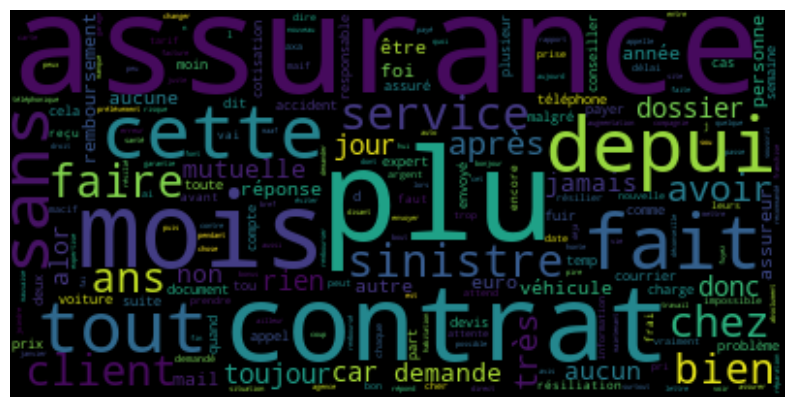

In [60]:
# NOTE 1
note1 = data_train[data_train['note'] == 1].avis.tolist()
note1 = [x for liste in note1 for x in liste]
note1 = ' '.join(note1).lower()
wordcloud1 = WordCloud(collocations=False).generate(note1)
plt.figure(figsize=(10,10))
plt.imshow(wordcloud1, interpolation='bilInear')
plt.axis('off')
plt.show()

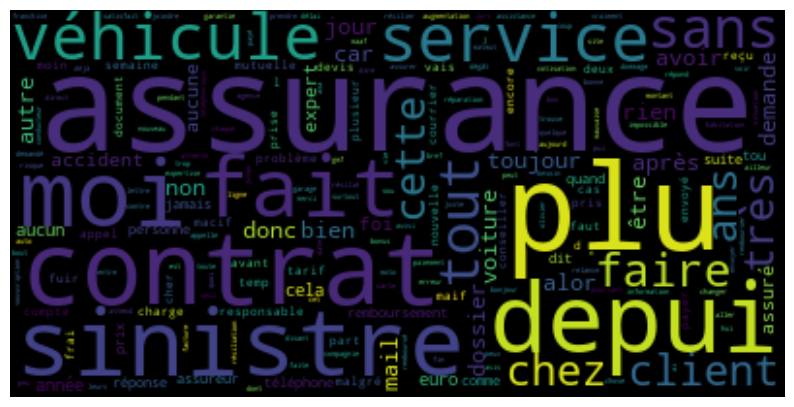

In [61]:
# NOTE 2
note2 = data_train[data_train['note'] == 2].avis.tolist()
note2 = [x for liste in note2 for x in liste]
note2 = ' '.join(note2).lower()
wordcloud2 = WordCloud(collocations=False).generate(note2)
plt.figure(figsize=(10,10))
plt.imshow(wordcloud2, interpolation='bilInear')
plt.axis('off')
plt.show()

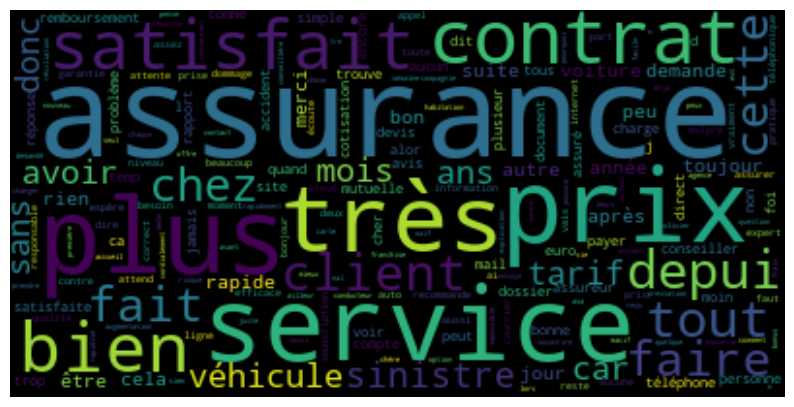

In [62]:
# NOTE 3
note3 = data_train[data_train['note'] == 3].avis.tolist()
note3 = [x for liste in note3 for x in liste]
note3 = ' '.join(note3).lower()
wordcloud3 = WordCloud(collocations=False).generate(note3)
plt.figure(figsize=(10,10))
plt.imshow(wordcloud3, interpolation='bilInear')
plt.axis('off')
plt.show()

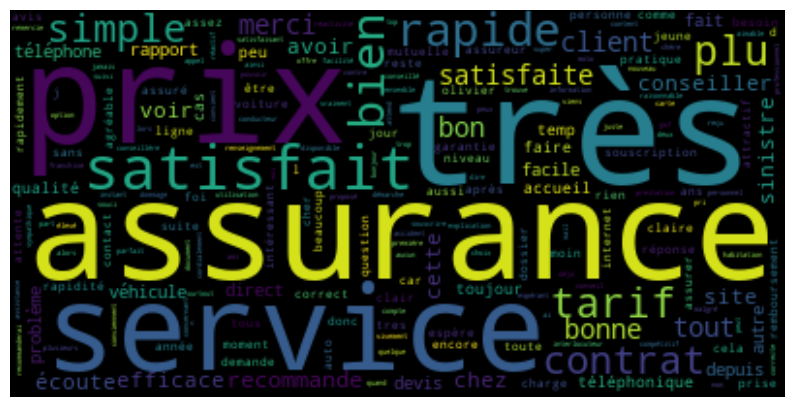

In [63]:
# NOTE 4
note4 = data_train[data_train['note'] == 4].avis.tolist()
note4 = [x for liste in note4 for x in liste]
note4 = ' '.join(note4).lower()
wordcloud4 = WordCloud(collocations=False).generate(note4)
plt.figure(figsize=(10,10))
plt.imshow(wordcloud4, interpolation='bilInear')
plt.axis('off')
plt.show()

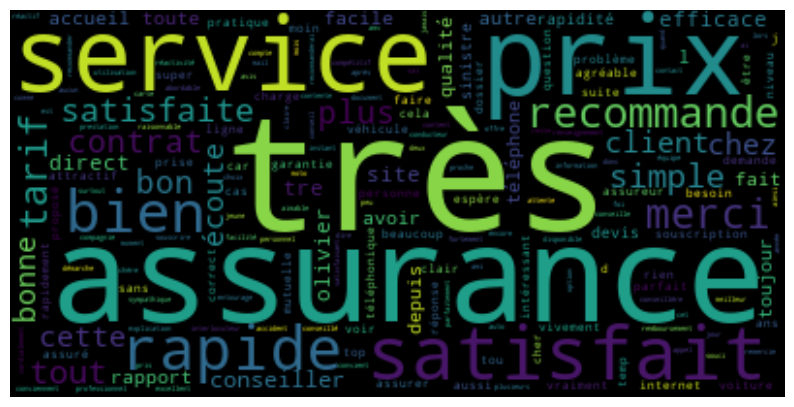

In [64]:
# NOTE 5
note5 = data_train[data_train['note'] == 5].avis.tolist()
note5 = [x for liste in note5 for x in liste]
note5 = ' '.join(note5).lower()
wordcloud5 = WordCloud(collocations=False).generate(note5)
plt.figure(figsize=(10,10))
plt.imshow(wordcloud5, interpolation='bilInear')
plt.axis('off')
plt.show()

note: here we can already remove the words present in the 5 categories of notes:
insurance, very, ...

<AxesSubplot:xlabel='assureur ', ylabel='note'>

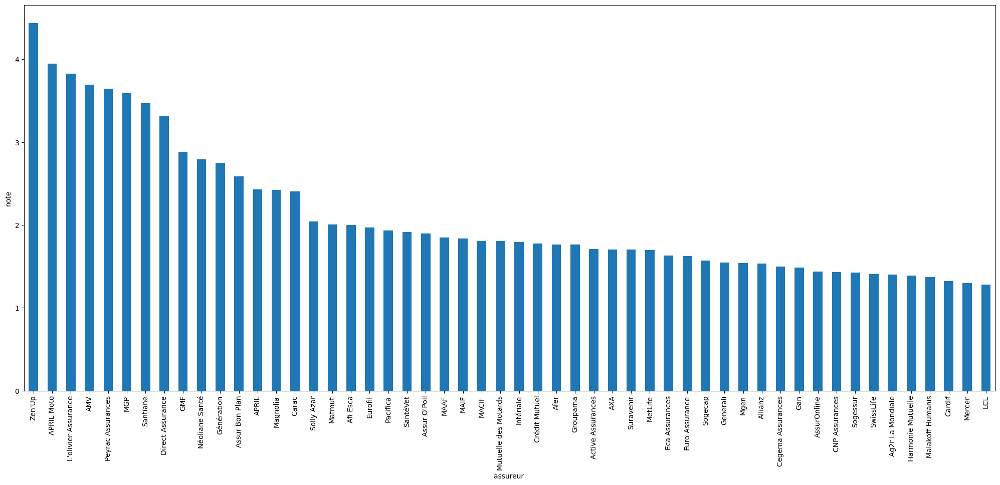

In [65]:
plt.figure(figsize=(25,10))
note_moyenne =  data_train.groupby(['assureur'])['note'].mean().sort_values(ascending=False)
note_moyenne.plot(kind='bar', xlabel='assureur ', ylabel = 'note')

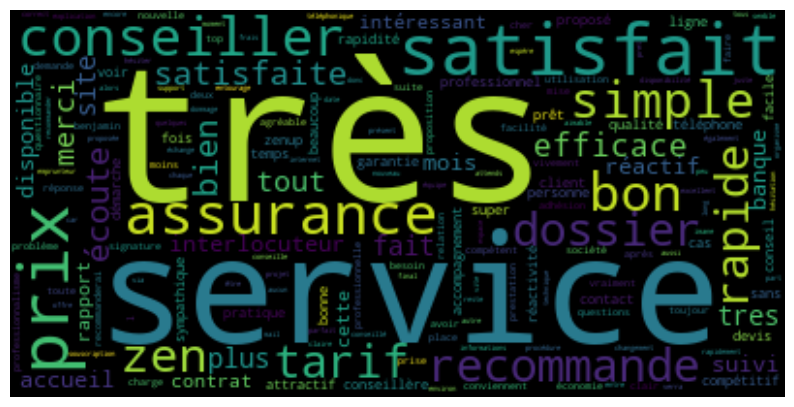

In [66]:
# ZEN UP
zen_up = data_train[data_train['assureur'] == "Zen'Up"].avis.tolist()
zen_up = [x for liste in zen_up for x in liste]
zen_up = ' '.join(zen_up).lower()
wordclou_zen = WordCloud(collocations=False).generate(zen_up)
plt.figure(figsize=(10,10))
plt.imshow(wordclou_zen, interpolation='bilInear')
plt.axis('off')
plt.show()

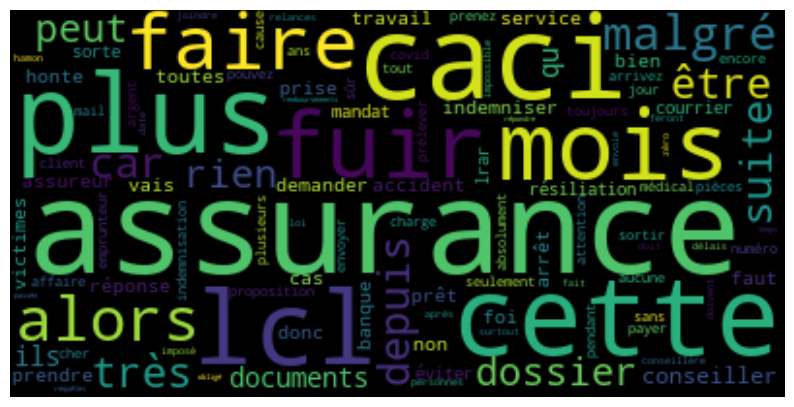

In [67]:
# LCL
lcl = data_train[data_train['assureur'] == "LCL"].avis.tolist()
lcl = [x for liste in lcl for x in liste]
lcl = ' '.join(lcl).lower()
wordclou_lcl = WordCloud(collocations=False).generate(lcl)
plt.figure(figsize=(10,10))
plt.imshow(wordclou_lcl, interpolation='bilInear')
plt.axis('off')
plt.show()

<AxesSubplot:xlabel='produit ', ylabel='note'>

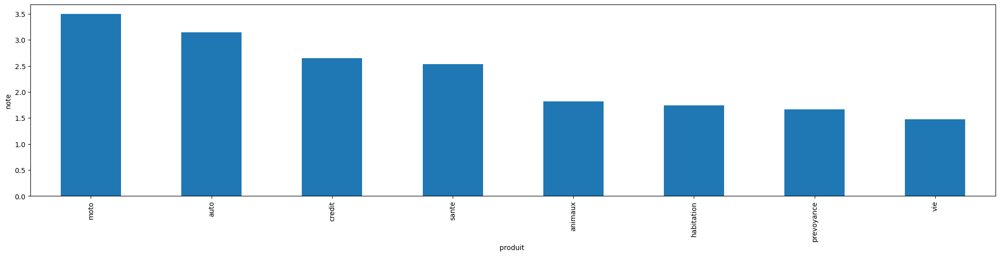

In [68]:
plt.figure(figsize=(25,5))
note_moyenne_produit =  data_train.groupby(['produit'])['note'].mean().sort_values(ascending=False)
note_moyenne_produit.plot(kind='bar', xlabel='produit ', ylabel = 'note')

note: here we see that the type of product will impact the score => for the supervised model this column will be very useful to us

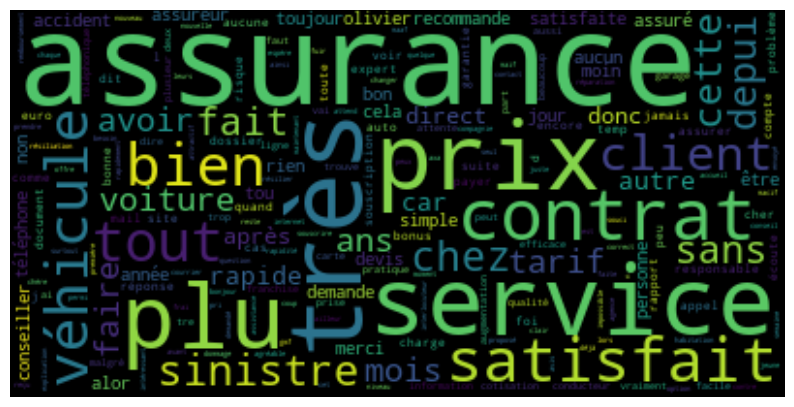

In [69]:
# auto
auto = data_train[data_train['produit'] == "auto"].avis.tolist()
auto = [x for liste in auto for x in liste]
auto = ' '.join(auto).lower()
wordclou_auto = WordCloud(collocations=False).generate(auto)
plt.figure(figsize=(10,10))
plt.imshow(wordclou_auto, interpolation='bilInear')
plt.axis('off')
plt.show()

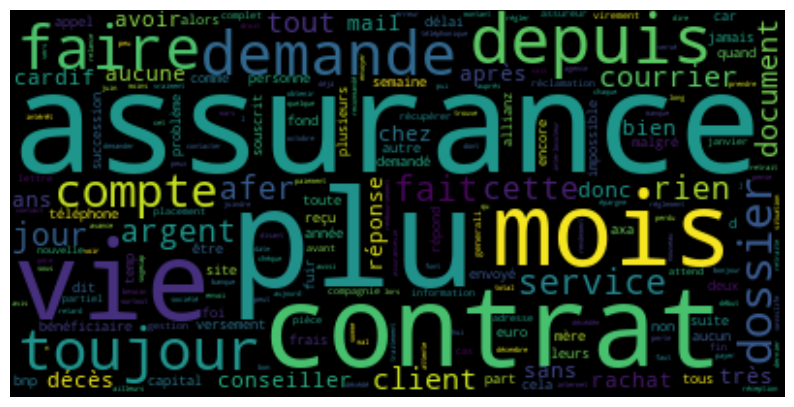

In [70]:
#responsabilite-civile-professionnelle
resp = data_train[data_train['produit'] == "vie"].avis.tolist()
resp = [x for liste in resp for x in liste]
resp = ' '.join(resp).lower()
wordclou_resp = WordCloud(collocations=False).generate(resp)
plt.figure(figsize=(10,10))
plt.imshow(wordclou_resp, interpolation='bilInear')
plt.axis('off')
plt.show()

# 5) Pre Processing for Unsepervised Model

In [71]:
data_train['avis'] = data_train['avis'].map(lambda x : list(set(x)))
data_train.head(1)

,date,note,auteur,avis,assureur,produit
0,2021-08-06,5,brahim--k-131532,"[meilleurs, rapidité, cette, services, prix, solutions, qualité, assurances, attractif, écoute, compagnie, recommande]",Direct Assurance,auto


In [76]:
words = data_train['avis'].tolist()
frequence = Counter([x for sublist in words for x in sublist])
frequence_sorted =sorted(frequence.items(), key=lambda x: x[1], reverse=True)
frequence_clean =[x for x in frequence_sorted if x[1]>100]
print(len(frequence_clean))
frequence_clean[:2]

1046


[('assurance', 8063), ('très', 6529)]

In [77]:
frq = [item[0] for item in frequence_clean]
data_train['avis2'] = data_train["avis"].map(lambda x : [y for y in list(x) if  y in frq])

In [78]:
#words2 = data_train['avis2'].tolist()
#frequence = Counter([x for sublist in words2 for x in sublist])
#frequence_sorted =sorted(frequence.items(), key=lambda x: x[1], reverse=True)
#frequence_clean =[x for x in frequence_sorted if x[1]>30]
#print(len(frequence_clean))
#frequence_clean[:20]

In [79]:
notes = data_train['note'].tolist()

def Convert(lst):
    res_dct = {lst[i]: lst[i + 1] for i in range(0, len(lst), 2)}
    return res_dct
words = data_train['avis2'].tolist()
unique_words = {x for l in words for x in l}
unique_words = list(unique_words)
result = []
for e in unique_words:
    result.append(e)
    result.append({1:0, 2:0, 3:0, 4:0, 5:0})

unique_words = Convert(result)

unique_words
#unique_words = dict.fromkeys(unique_words, {1:0, 2:0, 3:0, 4:0, 5:0})


for i in range(len(words)):
    for word in words[i]:
        unique_words[word][notes[i]]+=1        

In [80]:
unique_words["merci"]

{1: 207, 2: 122, 3: 251, 4: 474, 5: 747}

In [81]:
unique_words["assurance"]

{1: 2741, 2: 1349, 3: 968, 4: 1335, 5: 1670}

In [82]:
(unique_words["assurance"][1]/(unique_words["assurance"][1]+unique_words["assurance"][2]+unique_words["assurance"][3]+unique_words["assurance"][4]+unique_words["assurance"][5]))*100

33.994791020711894

In [83]:
(unique_words["merci"][5]/(unique_words["merci"][5]+unique_words["merci"][2]+unique_words["merci"][3]+unique_words["merci"][4]+unique_words["merci"][1]))*100

41.47695724597446

'assurance'  : we observe that these  word is present everywhere => we can logically remove it  because it will not be used
We can now make a list of words that are present everywhere (and we calculate the max frequency in rating and we remove the frequency under 35%)

In [84]:
mots_present_partout_equitablement = []
pourcentage = 35
for key in unique_words.keys():
    somme = unique_words[key][1]+unique_words[key][2]+unique_words[key][3]+unique_words[key][4]+unique_words[key][5]
    if( ((unique_words[key][1]/somme)*100<pourcentage)
      & ((unique_words[key][2]/somme)*100<pourcentage)
      & ((unique_words[key][3]/somme)*100<pourcentage)
      & ((unique_words[key][4]/somme)*100<pourcentage)
      & ((unique_words[key][5]/somme)*100<pourcentage)):
        mots_present_partout_equitablement.append(key)

mots_present_partout_equitablement

['joignable',
 'franchises',
 'marché',
 'application',
 'moment',
 'meilleurs',
 'rapidement',
 'tarifs',
 'professionnels',
 'reste',
 'jeune',
 'niveau',
 'bien',
 'convient',
 'difficulté',
 'explications',
 'ensemble',
 'souscription',
 'offres',
 'parrainage',
 'contacts',
 'ligne',
 'prestation',
 'direct',
 'signaler',
 'internet',
 'hauteur',
 'trouvé',
 'garanties',
 'bonne',
 'rapport',
 'revanche',
 'satisfaction',
 'relation',
 'conseillère',
 'espace',
 'concurrence',
 'telephone',
 'expliqué',
 'soucis',
 'conducteurs',
 'remise',
 'données',
 'présent',
 'véhicules',
 'tarif',
 'j’espère',
 'remplacement',
 'moto',
 'trés',
 'c’est',
 'services',
 'site',
 'besoin',
 'april',
 'démarche',
 'parfois',
 'ete',
 'ici',
 'prestations',
 'cordialement',
 'gmf',
 'pro',
 'conseillé',
 'permis',
 'conseiller',
 'petit',
 'attentes',
 'dommage',
 'interlocuteurs',
 'conseille',
 'choisi',
 'questions',
 'espère',
 'entretien',
 'également',
 'concerne',
 'compétent',
 'regrette

In [85]:
liste_mots_uniques = {x for l in words for x in l}
liste_mots_uniques = list(liste_mots_uniques)

In [86]:
main_list = list(set(liste_mots_uniques) - set(mots_present_partout_equitablement))
#main_list

In [87]:
len(mots_present_partout_equitablement)

164

In [88]:
len(main_list)

882

In [89]:
data_train['avis2'] = data_train["avis2"].map(lambda x : [y for y in list(x) if  y in main_list ])
print(data_train.shape)
data_train.head(1)

(24059, 7)


,date,note,auteur,avis,assureur,produit,avis2
0,2021-08-06,5,brahim--k-131532,"[meilleurs, rapidité, cette, services, prix, solutions, qualité, assurances, attractif, écoute, compagnie, recommande]",Direct Assurance,auto,"[rapidité, cette, qualité, écoute, compagnie, recommande]"


In [90]:
data_train['avis3'] = data_train["avis2"].map(lambda x : [y for y in list(x) if abs(tb(y).sentiment[0])>0.2])

In [91]:
data_train['avis4'] = data_train["avis"].map(lambda x : [y for y in list(x) if abs(tb(y).sentiment[0])>0.2])

In [92]:
data_train.head(5)

,date,note,auteur,avis,assureur,produit,avis2,avis3,avis4
0,2021-08-06,5,brahim--k-131532,"[meilleurs, rapidité, cette, services, prix, solutions, qualité, assurances, attractif, écoute, compagnie, recommande]",Direct Assurance,auto,"[rapidité, cette, qualité, écoute, compagnie, recommande]",[qualité],"[meilleurs, qualité]"
1,2021-05-03,4,bernard-g-112497,"[problème, déclarer, tentatives, internet, agréable, site, tout, satisfait, interlocutrice, déclaration, sinistre, compétente, très, globalement, faite, impossible, plusieurs, ligne, passé, après, sauf, téléphone, bien]",Direct Assurance,auto,"[problème, déclarer, agréable, tout, satisfait, interlocutrice, déclaration, sinistre, globalement, faite, impossible, plusieurs, passé, après, sauf, téléphone]","[agréable, tout, satisfait, sinistre, impossible]","[agréable, tout, satisfait, sinistre, impossible]"
2,2021-03-21,5,virginie-t-107352,"[fait, options, tres, prix, plusieurs, abordable, comme, voiture, zero, offrent, franchise, option, tout, plaisant, boitier, tranquiliter, connecter]",Direct Assurance,auto,"[fait, options, tres, plusieurs, abordable, comme, voiture, franchise, option, tout]",[tout],"[tout, plaisant]"
3,2021-06-10,4,boulain-f-116580,"[service, cordialement, réponse, satisfait, assurance, rapide, moins, marche, cher, remercie, très]",L'olivier Assurance,auto,"[réponse, satisfait, rapide, moins, marche, cher, remercie]","[satisfait, rapide, cher]","[satisfait, rapide, cher]"
4,2017-01-29,1,ouaille31-51798,"[tous, seul, protection, bonus, depuis, recherche, sait, inutiles, contrat, moins, juridique, fourguer, donc, mutuelle, office, besoin, plus, faire, cherchez, défendu, bref, sinistre, priorité, haut, essayer, descendre, agence, assureurs, ans, très, cette, client, contrats, chaque, possible, surtout, rien, but, hélas, devenu, immédiat, trop, déçu, contraire, avoir, fait, payer, maintenant, mettre, fois, défendre, moindre, dès, lot, profit, tords]",Matmut,auto,"[tous, seul, protection, bonus, depuis, recherche, sait, contrat, moins, juridique, donc, mutuelle, plus, faire, bref, sinistre, haut, agence, assureurs, ans, cette, client, contrats, chaque, possible, surtout, rien, trop, déçu, contraire, avoir, fait, payer, maintenant, mettre, fois, moindre, dès]","[tous, sinistre, trop, déçu]","[tous, inutiles, sinistre, hélas, immédiat, trop, déçu]"


# 6) Unsupervised model

In [94]:
model = Word2Vec(data_train['avis4'],vector_size=200, min_count=1,window=3)

In [95]:
#some example of a positive word
w1 = "merci"
model.wv.most_similar(positive=w1)

[('facile', 0.9992403984069824),
 ('clair', 0.9989296197891235),
 ('correct', 0.9987602233886719),
 ('satisfaite', 0.9986822605133057),
 ('agréable', 0.9986472725868225),
 ('amis', 0.9986457228660583),
 ('efficace', 0.9984214305877686),
 ('super', 0.9984158873558044),
 ('satisfait', 0.9981971979141235),
 ('claire', 0.9980888962745667)]

In [96]:
##some example of a negative word
w2 = "mauvais"
model.wv.most_similar(positive=w2)

[('absolument', 0.9996024370193481),
 ('honteux', 0.9995571374893188),
 ('propre', 0.9995556473731995),
 ('malheureusement', 0.9995512366294861),
 ('lamentable', 0.9995486736297607),
 ('final', 0.9995447993278503),
 ('plein', 0.9995376467704773),
 ('précise', 0.9995336532592773),
 ('juste', 0.9995332360267639),
 ('grave', 0.999531626701355)]

In [97]:
X = []
for key in model.wv.key_to_index.keys():
    X.append(model.wv[key])

In [99]:
pca = PCA(n_components=3)
principalComponents = pca.fit_transform(X)
pcaDF = pd.DataFrame(data = principalComponents, columns = ['pca1', 'pca2', 'pca3'])

In [100]:
mots = list(model.wv.key_to_index.keys())

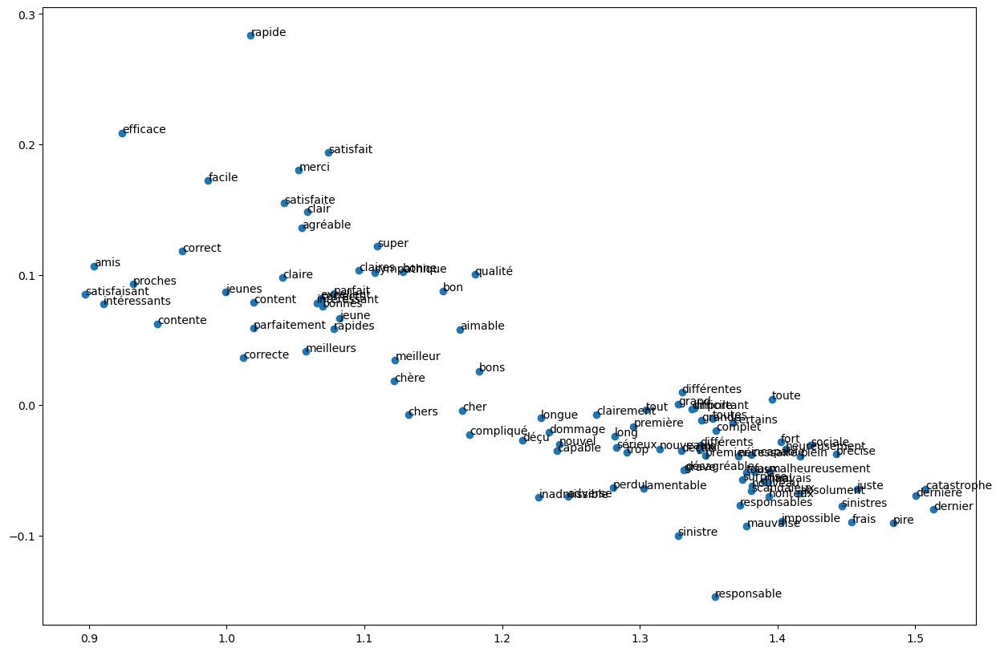

In [101]:
fig,ax = plt.subplots(figsize=(15,10))
ax.scatter(pcaDF['pca1'][:100],pcaDF['pca2'][:100])
for i,txt in enumerate(mots[:100]):
    ax.annotate(txt,(pcaDF['pca1'][i],pcaDF['pca2'][i]),fontsize=10)

In [102]:
pcaDF['complete_coord'] = X
pcaDF['coordinates'] = list(zip(pcaDF.pca1, pcaDF.pca2, pcaDF.pca3))
pcaDF['mot']=mots
pcaDF['sentiment']=[tb(x).sentiment[0] for x in mots]

In [103]:
fig = px.scatter_3d(pcaDF, x='pca1', y='pca2', z='pca3',color='sentiment' )
fig.show()

In [104]:
dico = dict(zip(pcaDF.mot, pcaDF.coordinates))

In [105]:
list_mots = list(data_train['avis4'])
np_array_coord_bis=[]
for x in list_mots:
    list_inter_bis= []
    if isinstance(x,list):
        for y in x:
            list_inter_bis.append(list(dico[y]))
    else:
        list_inter_bis.append(list(dico[x]))           
    np_array_coord_bis.append(list_inter_bis)

In [106]:
np_array_coord_bis[0]

[[1.0572902659924783, 0.04117777812063816, -0.0015082211610652398],
 [1.1802157892234477, 0.10035574704075667, -0.004718917536165814]]

In [107]:
data_train['coord_mots'] = np_array_coord_bis
data_train.head(1)

,date,note,auteur,avis,assureur,produit,avis2,avis3,avis4,coord_mots
0,2021-08-06,5,brahim--k-131532,"[meilleurs, rapidité, cette, services, prix, solutions, qualité, assurances, attractif, écoute, compagnie, recommande]",Direct Assurance,auto,"[rapidité, cette, qualité, écoute, compagnie, recommande]",[qualité],"[meilleurs, qualité]","[[1.0572902659924783, 0.04117777812063816, -0.0015082211610652398], [1.1802157892234477, 0.10035574704075667, -0.004718917536165814]]"


In [108]:
data_train['moy_coord_mots'] = data_train["coord_mots"].map(lambda x : np.average(x,axis=0))
data_train.head(1)

C:\Users\suvin\anaconda3\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning:

Mean of empty slice.

C:\Users\suvin\anaconda3\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning:

invalid value encountered in double_scalars



,date,note,auteur,avis,assureur,produit,avis2,avis3,avis4,coord_mots,moy_coord_mots
0,2021-08-06,5,brahim--k-131532,"[meilleurs, rapidité, cette, services, prix, solutions, qualité, assurances, attractif, écoute, compagnie, recommande]",Direct Assurance,auto,"[rapidité, cette, qualité, écoute, compagnie, recommande]",[qualité],"[meilleurs, qualité]","[[1.0572902659924783, 0.04117777812063816, -0.0015082211610652398], [1.1802157892234477, 0.10035574704075667, -0.004718917536165814]]","[1.118753027607963, 0.07076676258069742, -0.003113569348615527]"


In [109]:
data_train = data_train[data_train['moy_coord_mots'].notna()]

In [110]:
d = list(data_train['moy_coord_mots'])
d[0]

array([ 1.11875303,  0.07076676, -0.00311357])

In [111]:
kmeans = KMeans(n_clusters=5)
kmeans.fit(d)
data_train['cluster'] = kmeans.labels_
data_train.head(1)

C:\Users\suvin\AppData\Local\Temp\ipykernel_4864\2273768623.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,date,note,auteur,avis,assureur,produit,avis2,avis3,avis4,coord_mots,moy_coord_mots,cluster
0,2021-08-06,5,brahim--k-131532,"[meilleurs, rapidité, cette, services, prix, solutions, qualité, assurances, attractif, écoute, compagnie, recommande]",Direct Assurance,auto,"[rapidité, cette, qualité, écoute, compagnie, recommande]",[qualité],"[meilleurs, qualité]","[[1.0572902659924783, 0.04117777812063816, -0.0015082211610652398], [1.1802157892234477, 0.10035574704075667, -0.004718917536165814]]","[1.118753027607963, 0.07076676258069742, -0.003113569348615527]",0


In [112]:
data_train[['coord_x','coord_y','coord_z']] = pd.DataFrame(data_train.moy_coord_mots.tolist(), index= data_train.index)
data_train.head(1)

C:\Users\suvin\AppData\Local\Temp\ipykernel_4864\2140927388.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\suvin\AppData\Local\Temp\ipykernel_4864\2140927388.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\suvin\AppData\Local\Temp\ipykernel_4864\2140927388.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-d

,date,note,auteur,avis,assureur,produit,avis2,avis3,avis4,coord_mots,moy_coord_mots,cluster,coord_x,coord_y,coord_z
0,2021-08-06,5,brahim--k-131532,"[meilleurs, rapidité, cette, services, prix, solutions, qualité, assurances, attractif, écoute, compagnie, recommande]",Direct Assurance,auto,"[rapidité, cette, qualité, écoute, compagnie, recommande]",[qualité],"[meilleurs, qualité]","[[1.0572902659924783, 0.04117777812063816, -0.0015082211610652398], [1.1802157892234477, 0.10035574704075667, -0.004718917536165814]]","[1.118753027607963, 0.07076676258069742, -0.003113569348615527]",0,1.118753,0.070767,-0.003114


In [113]:
#data_train = pd.read_csv("C:\\ESILV_ANNEE_5\\MachineLearningNLP\\avisCompetTrain.csv",sep=',')

In [114]:
fig = px.scatter_3d(data_train, x='coord_x', y='coord_y', z='coord_z',
              color='cluster')
fig.show()

In [115]:
fig = px.scatter_3d(data_train, x='coord_x', y='coord_y', z='coord_z',
              color='note')
fig.show()

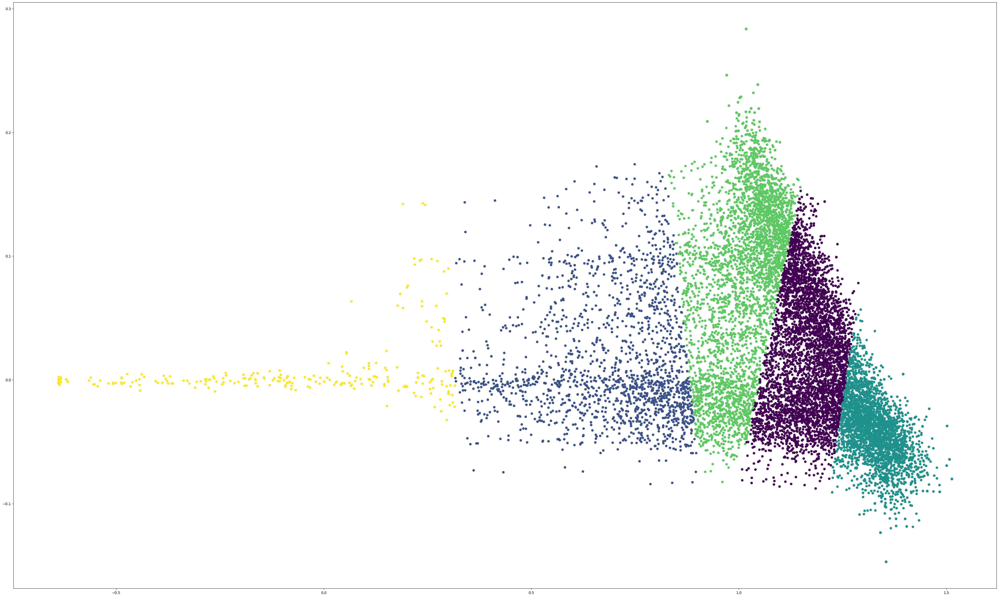

In [117]:
fig,ax = plt.subplots(figsize=(50,30))
ax.scatter(data_train['coord_x'],data_train['coord_y'],c=data_train['cluster'],cmap='viridis')

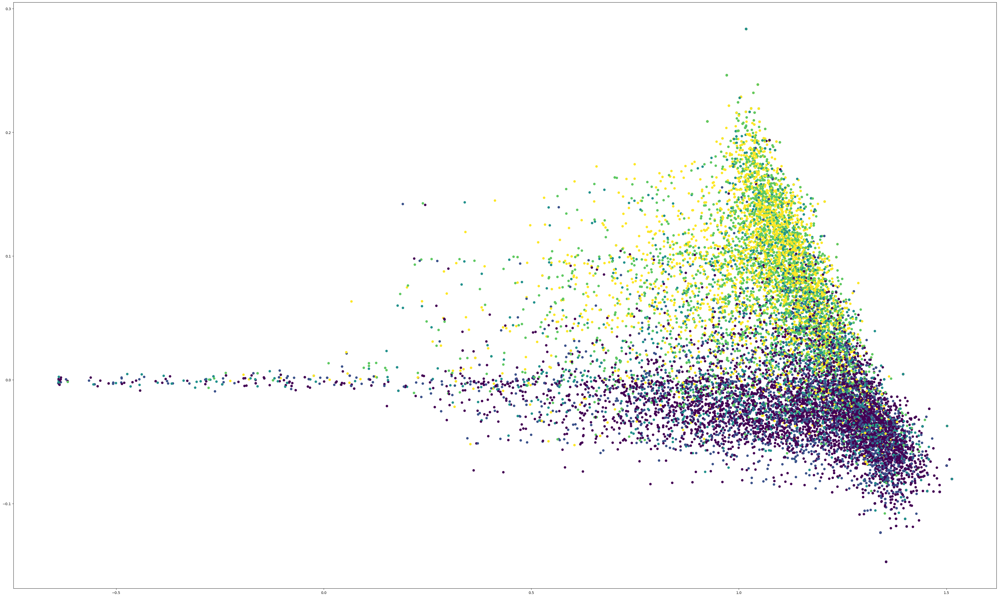

In [118]:
fig,ax = plt.subplots(figsize=(50,30))
ax.scatter(data_train['coord_x'],data_train['coord_y'],c=data_train['note'],cmap='viridis')

In [120]:
senti_list = []
for i in data_train["avis4"]:
    valeur = 0
    size = 0
    for j in i:
        if(abs(tb(j).sentiment[0]) > 0.1):
            valeur += tb(j).sentiment[0]
            size += 1
    if(size > 0):
        valeur = valeur/size
    senti_list.append(valeur)

In [121]:
data_train["sentiment"]=senti_list
data_train.head(4)

C:\Users\suvin\AppData\Local\Temp\ipykernel_4864\2455364655.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,date,note,auteur,avis,assureur,produit,avis2,avis3,avis4,coord_mots,moy_coord_mots,cluster,coord_x,coord_y,coord_z,sentiment
0,2021-08-06,5,brahim--k-131532,"[meilleurs, rapidité, cette, services, prix, solutions, qualité, assurances, attractif, écoute, compagnie, recommande]",Direct Assurance,auto,"[rapidité, cette, qualité, écoute, compagnie, recommande]",[qualité],"[meilleurs, qualité]","[[1.0572902659924783, 0.04117777812063816, -0.0015082211610652398], [1.1802157892234477, 0.10035574704075667, -0.004718917536165814]]","[1.118753027607963, 0.07076676258069742, -0.003113569348615527]",0,1.118753,0.070767,-0.003114,0.465000
1,2021-05-03,4,bernard-g-112497,"[problème, déclarer, tentatives, internet, agréable, site, tout, satisfait, interlocutrice, déclaration, sinistre, compétente, très, globalement, faite, impossible, plusieurs, ligne, passé, après, sauf, téléphone, bien]",Direct Assurance,auto,"[problème, déclarer, agréable, tout, satisfait, interlocutrice, déclaration, sinistre, globalement, faite, impossible, plusieurs, passé, après, sauf, téléphone]","[agréable, tout, satisfait, sinistre, impossible]","[agréable, tout, satisfait, sinistre, impossible]","[[1.0547640725163436, 0.1358191911927855, 0.009268343465893447], [1.3044359711508378, -0.003876725996800845, 0.004853716378523015], [1.0739397654681544, 0.19364500764234344, 0.005720023968727424], [1.3276472351849304, -0.09989251459786502, -0.003641767022706294], [1.4030689826017588, -0.08915128222009083, 0.006829222881526865]]","[1.2327712053844049, 0.027308735204074452, 0.004605907934392892]",0,1.232771,0.027309,0.004606,0.014000
2,2021-03-21,5,virginie-t-107352,"[fait, options, tres, prix, plusieurs, abordable, comme, voiture, zero, offrent, franchise, option, tout, plaisant, boitier, tranquiliter, connecter]",Direct Assurance,auto,"[fait, options, tres, plusieurs, abordable, comme, voiture, franchise, option, tout]",[tout],"[tout, plaisant]","[[1.3044359711508378, -0.003876725996800845, 0.004853716378523015], [-0.17610930085920193, 0.0012022133520129795, 0.004651223051745014]]","[0.564163335145818, -0.001337256322393933, 0.004752469715134015]",1,0.564163,-0.001337,0.004752,0.410000
3,2021-06-10,4,boulain-f-116580,"[service, cordialement, réponse, satisfait, assurance, rapide, moins, marche, cher, remercie, très]",L'olivier Assurance,auto,"[réponse, satisfait, rapide, moins, marche, cher, remercie]","[satisfait, rapide, cher]","[satisfait, rapide, cher]","[[1.0739397654681544, 0.19364500764234344, 0.005720023968727424], [1.0175552548368847, 0.2834619145182531, 0.054383793354280716], [1.1710899913703132, -0.0039967207525986505, 0.004835944045218631]]","[1.0875283372251174, 0.15770340046933262, 0.021646587122742256]",3,1.087528,0.157703,0.021647,0.146667


In [123]:
d = data_train[['sentiment','coord_x','coord_y','coord_z']].to_numpy()
d[0]

array([ 0.465     ,  1.11875303,  0.07076676, -0.00311357])

In [124]:
kmeans2 = KMeans(n_clusters=5)
kmeans2.fit(d)
data_train['cluster_sentiment'] = kmeans2.labels_
data_train.head(1)

C:\Users\suvin\AppData\Local\Temp\ipykernel_4864\142265690.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,date,note,auteur,avis,assureur,produit,avis2,avis3,avis4,coord_mots,moy_coord_mots,cluster,coord_x,coord_y,coord_z,sentiment,cluster_sentiment
0,2021-08-06,5,brahim--k-131532,"[meilleurs, rapidité, cette, services, prix, solutions, qualité, assurances, attractif, écoute, compagnie, recommande]",Direct Assurance,auto,"[rapidité, cette, qualité, écoute, compagnie, recommande]",[qualité],"[meilleurs, qualité]","[[1.0572902659924783, 0.04117777812063816, -0.0015082211610652398], [1.1802157892234477, 0.10035574704075667, -0.004718917536165814]]","[1.118753027607963, 0.07076676258069742, -0.003113569348615527]",0,1.118753,0.070767,-0.003114,0.465,2


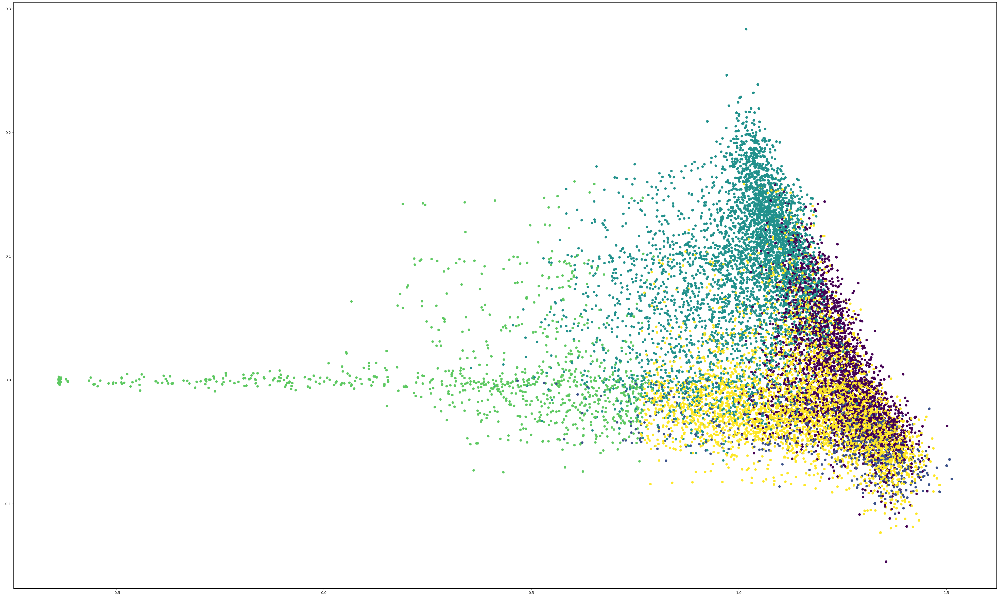

In [125]:
fig,ax = plt.subplots(figsize=(50,30))
ax.scatter(data_train['coord_x'],data_train['coord_y'],c=data_train['cluster_sentiment'],cmap='viridis')

# 6) Preprocessing for supervised

new features:
- number of words
- average word size
- one hot on the insurer and on the product

In [127]:
data_train["avis"][0]

['meilleurs',
 'rapidité',
 'cette',
 'services',
 'prix',
 'solutions',
 'qualité',
 'assurances',
 'attractif',
 'écoute',
 'compagnie',
 'recommande']

In [128]:
def averageLen(lst):
    lengths = [len(i) for i in lst]
    return 0 if len(lengths) == 0 else (float(sum(lengths)) / len(lengths)) 

lengths = [averageLen(i) for i in data_train["avis"]]
data_train["longueur_moyenne"] = lengths

C:\Users\suvin\AppData\Local\Temp\ipykernel_4864\3192411054.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [129]:
counts = [len(i) for i in data_train["avis"]]
data_train["nombre_de_mots"] = counts

C:\Users\suvin\AppData\Local\Temp\ipykernel_4864\2874811812.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [130]:
# One-hot encoding
one_hot = pd.get_dummies(data_train['assureur'])

# Add one-hot encoded columns to original dataframe
data_train = data_train.join(one_hot)

In [131]:
# One-hot encoding
one_hot = pd.get_dummies(data_train['produit'])
# Add one-hot encoded columns to original dataframe
data_train = data_train.join(one_hot)

In [133]:
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import MinMaxScaler

In [265]:
X = data_train.iloc[:,12:]
X.drop(columns=["cluster_sentiment"],inplace=True)
X["longueur_moyenne"] = MinMaxScaler().fit_transform(np.array(X["longueur_moyenne"]).reshape(-1,1))
X["nombre_de_mots"] = MinMaxScaler().fit_transform(np.array(X["nombre_de_mots"]).reshape(-1,1))
X

,coord_x,coord_y,coord_z,sentiment,longueur_moyenne,nombre_de_mots,AMV,APRIL,APRIL Moto,AXA,Active Assurances,Afer,Afi Esca,Ag2r La Mondiale,Allianz,Assur Bon Plan,Assur O'Poil,AssurOnline,CNP Assurances,Carac,Cardif,Cegema Assurances,Crédit Mutuel,Direct Assurance,Eca Assurances,Euro-Assurance,Eurofil,GMF,Gan,Generali,Groupama,Génération,Harmonie Mutuelle,Intériale,L'olivier Assurance,LCL,MAAF,MACIF,MAIF,MGP,Magnolia,Malakoff Humanis,Matmut,Mercer,MetLife,Mgen,Mutuelle des Motards,Néoliane Santé,Pacifica,Peyrac Assurances,Santiane,SantéVet,Sogecap,Sogessur,Solly Azar,Suravenir,SwissLife,Zen'Up,animaux,auto,credit,habitation,moto,prevoyance,sante,vie
0,1.118753,0.070767,-0.003114,0.465000,0.204724,0.022177,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
1,1.232771,0.027309,0.004606,0.014000,0.190003,0.044355,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
2,0.564163,-0.001337,0.004752,0.410000,0.154238,0.032258,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
3,1.087528,0.157703,0.021647,0.146667,0.165354,0.020161,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
4,1.024741,-0.034027,-0.000393,-0.261429,0.119798,0.110887,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24100,1.285502,-0.031786,0.000395,0.157500,0.157480,0.070565,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
24101,1.365358,-0.094522,0.001594,-0.575000,0.206693,0.030242,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
24102,1.256739,-0.030667,0.003792,0.152000,0.158658,0.254032,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
24103,1.304436,-0.003877,0.004854,0.220000,0.123604,0.084677,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0


In [266]:
y = data_train["note"]

In [136]:
np.unique(y)

array([1, 2, 3, 4, 5], dtype=int64)

In [137]:
from sklearn.model_selection import train_test_split
y = data_train["note"]
test_size = 0.33
X_train, X_test, Y_train, Y_test = train_test_split(X, y, test_size=test_size)

In [138]:
np.unique(Y_test)

array([1, 2, 3, 4, 5], dtype=int64)

### 1st model : linear regression

In [139]:
# Create a LinearRegression model
model = LinearRegression()

# Fit the model to the data
model.fit(X_train, Y_train)

# Use the model to make predictions
y_pred = model.predict(X_test)

In [140]:
y_pred = np.round(y_pred, 0)
y_pred = np.clip(y_pred, 1, 1000)
y_pred

array([1., 4., 1., ..., 2., 5., 2.])

In [141]:
from sklearn.metrics import mean_absolute_error,mean_squared_error, r2_score
import math

MSE = mean_squared_error(Y_test, y_pred)
RMSE = math.sqrt(MSE)
mae = mean_absolute_error(Y_test, y_pred)
r2 = r2_score(Y_test, y_pred)
accuracy = model.score(X_test,Y_test)

print(f'Mean squared error: {MSE:.2f}')
print(f'Root Mean squared error: {RMSE:.2f}')
print(f'Mean absolute error: {mae:.2f}')
print(f'R2 score: {r2:.2f}')
print(f'Accuracy: {accuracy:.2f}')

Mean squared error: 1.15
Root Mean squared error: 1.07
Mean absolute error: 0.81
R2 score: 0.51
Accuracy: 0.55


In [142]:
n= X.shape[0]
p = X.shape[1] + 1
variance = mean_squared_error(Y_test, y_pred) * (n - p - 1) / n
variance

1.1502168601757303

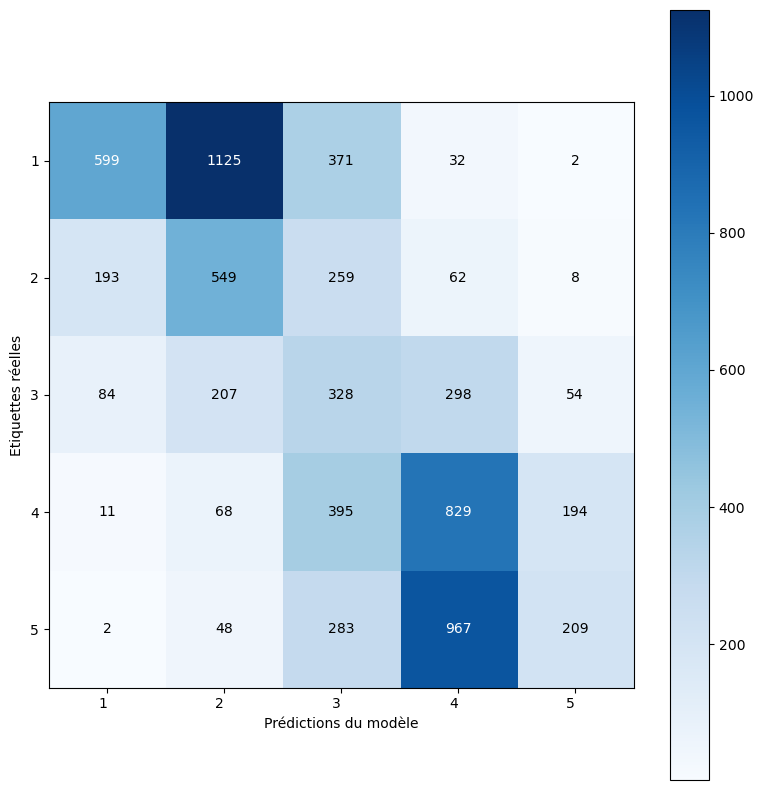

In [143]:
from sklearn.metrics import confusion_matrix
# Création de la matrice de confusion
confusion_mat = confusion_matrix(Y_test, y_pred)

# Affichage de la matrice de confusion
fig, ax = plt.subplots(figsize=(8, 8))
im = ax.imshow(confusion_mat, interpolation='nearest', cmap=plt.cm.Blues)
ax.figure.colorbar(im, ax=ax)

# On met en place les étiquettes des axes
ax.set(xticks=np.arange(confusion_mat.shape[1]),
       yticks=np.arange(confusion_mat.shape[0]),
       # ... et les étiquettes des classes
       xticklabels=['1', '2','3', '4','5'], yticklabels=['1', '2','3', '4','5'],
       ylabel='Etiquettes réelles',
       xlabel='Prédictions du modèle')

# Tourne les étiquettes des axes horizontalement
plt.setp(ax.get_xticklabels(), ha="right",
         rotation_mode="anchor")

# Boucle sur les points de données et affiche leur valeur
thresh = confusion_mat.max() / 2.
for i in range(confusion_mat.shape[0]):
    for j in range(confusion_mat.shape[1]):
        ax.text(j, i, confusion_mat[i, j],
                ha="center", va="center",
                color="white" if confusion_mat[i, j] > thresh else "black")


fig.tight_layout()
plt.show()

### 2nd model  : logistic regression

In [144]:
from sklearn.linear_model import LogisticRegression

In [145]:
# Create a LinearRegression model
model = LogisticRegression()

# Fit the model to the data
model.fit(X_train, Y_train)

# Use the model to make predictions
y_pred = model.predict(X_test)

C:\Users\suvin\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



In [146]:
y_pred = np.round(y_pred, 0)
y_pred = np.clip(y_pred, 1, 1000)
y_pred

array([1, 4, 1, ..., 1, 5, 1], dtype=int64)

In [147]:
MSE = mean_squared_error(Y_test, y_pred)
RMSE = math.sqrt(MSE)
mae = mean_absolute_error(Y_test, y_pred)
r2 = r2_score(Y_test, y_pred)
accuracy = model.score(X_test,Y_test)

print(f'Mean squared error: {MSE:.2f}')
print(f'Root Mean squared error: {RMSE:.2f}')
print(f'Mean absolute error: {mae:.2f}')
print(f'R2 score: {r2:.2f}')
print(f'Accuracy: {accuracy:.2f}')

Mean squared error: 1.47
Root Mean squared error: 1.21
Mean absolute error: 0.77
R2 score: 0.38
Accuracy: 0.48


In [148]:
n= X.shape[0]
p = X.shape[1] + 1
variance = mean_squared_error(Y_test, y_pred) * (n - p - 1) / n
variance

1.4613490624210674

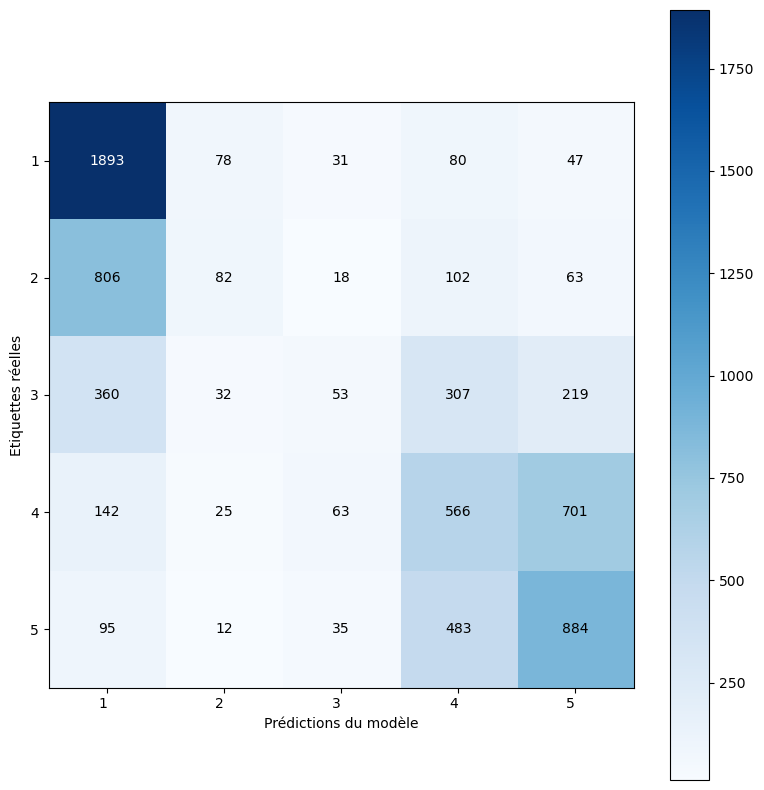

In [149]:
# Création de la matrice de confusion
confusion_mat = confusion_matrix(Y_test, y_pred)

# Affichage de la matrice de confusion
fig, ax = plt.subplots(figsize=(8, 8))
im = ax.imshow(confusion_mat, interpolation='nearest', cmap=plt.cm.Blues)
ax.figure.colorbar(im, ax=ax)

# On met en place les étiquettes des axes
ax.set(xticks=np.arange(confusion_mat.shape[1]),
       yticks=np.arange(confusion_mat.shape[0]),
       # ... et les étiquettes des classes
       xticklabels=['1', '2','3', '4','5'], yticklabels=['1', '2','3', '4','5'],
       ylabel='Etiquettes réelles',
       xlabel='Prédictions du modèle')

# Tourne les étiquettes des axes horizontalement
plt.setp(ax.get_xticklabels(), ha="right",
         rotation_mode="anchor")

# Boucle sur les points de données et affiche leur valeur
thresh = confusion_mat.max() / 2.
for i in range(confusion_mat.shape[0]):
    for j in range(confusion_mat.shape[1]):
        ax.text(j, i, confusion_mat[i, j],
                ha="center", va="center",
                color="white" if confusion_mat[i, j] > thresh else "black")


fig.tight_layout()
plt.show()

### 3rd model : XGBOOST

In [150]:
import xgboost as xgb
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
Y_train = le.fit_transform(Y_train)

In [151]:
# Create a LinearRegression model
model = xgb.XGBRegressor()

# Fit the model to the data
model.fit(X_train, Y_train)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=100, n_jobs=None, num_parallel_tree=None,
             predictor=None, random_state=None, ...)

In [152]:
# Use the model to make predictions
y_pred = model.predict(X_test)

In [153]:
np.unique(y_pred)

array([-0.9859644, -0.6359081, -0.5960091, ...,  4.220765 ,  4.3349195,
        4.99793  ], dtype=float32)

In [154]:
y_pred = np.round(y_pred, 0)
y_pred = np.clip(y_pred, 0, 4)
y_pred = [x+1 for x in y_pred]
y_pred = np.array(y_pred)
y_pred

array([2., 4., 2., ..., 2., 4., 1.])

In [155]:
MSE = mean_squared_error(Y_test, y_pred)
RMSE = math.sqrt(MSE)
mae = mean_absolute_error(Y_test, y_pred)
r2 = r2_score(Y_test, y_pred)

print(f'Mean squared error: {MSE:.2f}')
print(f'Root Mean squared error: {RMSE:.2f}')
print(f'Mean absolute error: {mae:.2f}')
print(f'R2 score: {r2:.2f}')

Mean squared error: 1.07
Root Mean squared error: 1.03
Mean absolute error: 0.76
R2 score: 0.55


In [156]:
n= X.shape[0]
p = X.shape[1] + 1
variance = mean_squared_error(Y_test, y_pred) * (n - p - 1) / n
variance

1.0639610130353936

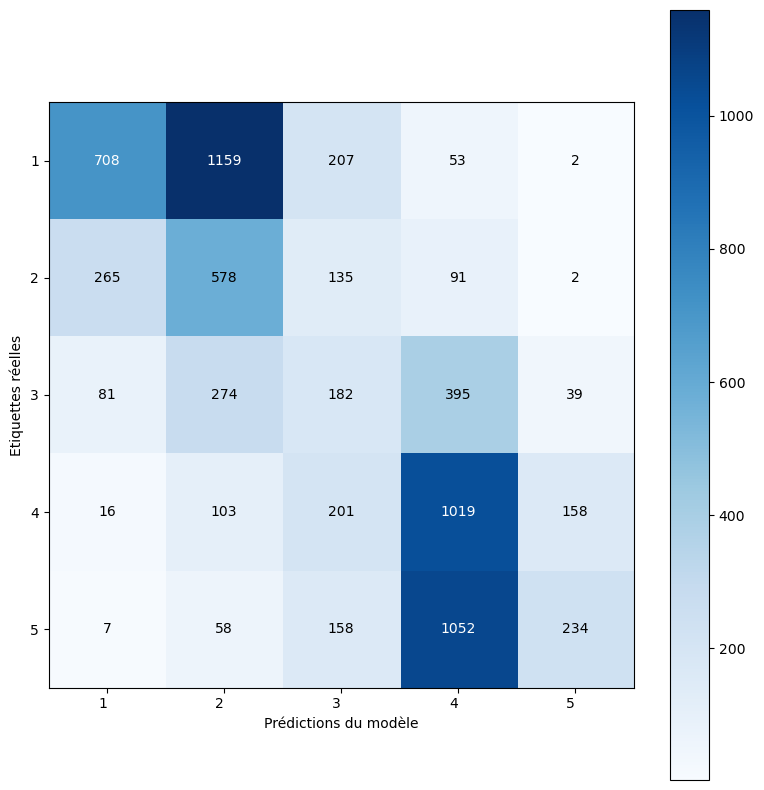

In [157]:
# Création de la matrice de confusion
confusion_mat = confusion_matrix(Y_test, y_pred)

# Affichage de la matrice de confusion
fig, ax = plt.subplots(figsize=(8, 8))
im = ax.imshow(confusion_mat, interpolation='nearest', cmap=plt.cm.Blues)
ax.figure.colorbar(im, ax=ax)

# On met en place les étiquettes des axes
ax.set(xticks=np.arange(confusion_mat.shape[1]),
       yticks=np.arange(confusion_mat.shape[0]),
       # ... et les étiquettes des classes
       xticklabels=['1', '2','3', '4','5'], yticklabels=['1', '2','3', '4','5'],
       ylabel='Etiquettes réelles',
       xlabel='Prédictions du modèle')

# Tourne les étiquettes des axes horizontalement
plt.setp(ax.get_xticklabels(), ha="right",
         rotation_mode="anchor")

# Boucle sur les points de données et affiche leur valeur
thresh = confusion_mat.max() / 2.
for i in range(confusion_mat.shape[0]):
    for j in range(confusion_mat.shape[1]):
        ax.text(j, i, confusion_mat[i, j],
                ha="center", va="center",
                color="white" if confusion_mat[i, j] > thresh else "black")


fig.tight_layout()
plt.show()

In [158]:
np.unique(Y_test)

array([1, 2, 3, 4, 5], dtype=int64)

In [159]:
Y_test = [x-1 for x in Y_test]
Y_test = np.array(Y_test)
np.unique(Y_test)

array([0, 1, 2, 3, 4])

In [162]:
a= model.score(X_test,Y_test)
print("accuracy of xgb regressor : ",a)

accuracy of xgb regressor :  0.5919334693418628


### 4th model : LIGHTGBM

In [166]:
import lightgbm as lgb
from sklearn.model_selection import train_test_split
model = lgb.LGBMClassifier()

X_train, X_test, y_train, y_test = train_test_split(X.to_numpy(), y, test_size=0.2, random_state=42)

lgb_train = lgb.Dataset(X_train, y_train)
lgb_test = lgb.Dataset(X_test, y_test, reference=lgb_train)

params = {
    'objective': 'multiclassova',  # for multiclass classification with target labels in the range [1, 5]
    'metric': 'multi_error',
    'num_leaves': 31,
    'learning_rate': 0.05,
    'verbose': 0,
    'num_class': 6  # number of classes
}

# Fit the model to the data
gbm = lgb.train(params,
                lgb_train,
                num_boost_round=20,
                valid_sets=lgb_test,
                early_stopping_rounds=5)

[LightGBM] [Warning] Contains only one class
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000210 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[1]	valid_0's multi_error: 0.716322
Training until validation scores don't improve for 5 rounds
[2]	valid_0's multi_error: 0.716322
[3]	valid_0's multi_error: 0.671494
[4]	valid_0's multi_error: 0.571494
[5]	valid_0's multi_error: 0.547126
[6]	valid_0's multi_error: 0.542989
[7]	valid_0's multi_error: 0.537701
[8]	valid_0's multi_error: 0.537241
[9]	valid_0's multi_error: 0.534253
[10]	valid_0's multi_error: 0.533793
[11]	valid_0's multi_error: 0.534023
[12]	valid_0's multi_error: 0.533103
[13]	valid_0's multi_error: 0.531954
[14]	valid_0's multi_error: 0.531034
[15]	valid_0's multi_error: 0.529885
[16]	valid_0's multi_error: 0.530115
[17]	valid_0's multi_error: 0.529195
[18]	valid_0's multi_error: 0.528276
[19]	vali

C:\Users\suvin\anaconda3\lib\site-packages\lightgbm\engine.py:181: UserWarning:

'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.



In [167]:
y_pred = gbm.predict(X_test, num_iteration=gbm.best_iteration)

In [168]:
y_pred = np.argmax(y_pred, axis=1)

In [173]:
MSE = mean_squared_error(y_test, y_pred)
RMSE = math.sqrt(MSE)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f'Mean squared error: {MSE:.2f}')
print(f'Root Mean squared error: {RMSE:.2f}')
print(f'Mean absolute error: {mae:.2f}')
print(f'R2 score: {r2:.2f}')

Mean squared error: 1.64
Root Mean squared error: 1.28
Mean absolute error: 0.81
R2 score: 0.30


In [174]:
n= X.shape[0]
p = X.shape[1] + 1
variance = mean_squared_error(y_test, y_pred) * (n - p - 1) / n
variance

1.6389969286290775

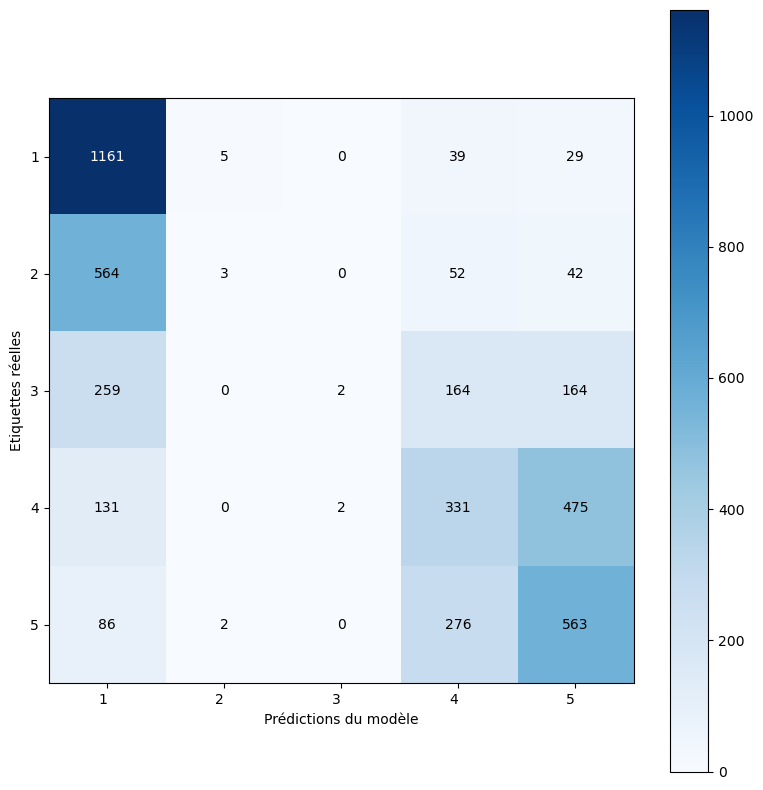

In [175]:
# Création de la matrice de confusion
confusion_mat = confusion_matrix(y_test, y_pred)

# Affichage de la matrice de confusion
fig, ax = plt.subplots(figsize=(8, 8))
im = ax.imshow(confusion_mat, interpolation='nearest', cmap=plt.cm.Blues)
ax.figure.colorbar(im, ax=ax)

# On met en place les étiquettes des axes
ax.set(xticks=np.arange(confusion_mat.shape[1]),
       yticks=np.arange(confusion_mat.shape[0]),
       # ... et les étiquettes des classes
       xticklabels=['1', '2','3', '4','5'], yticklabels=['1', '2','3', '4','5'],
       ylabel='Etiquettes réelles',
       xlabel='Prédictions du modèle')

# Tourne les étiquettes des axes horizontalement
plt.setp(ax.get_xticklabels(), ha="right",
         rotation_mode="anchor")

# Boucle sur les points de données et affiche leur valeur
thresh = confusion_mat.max() / 2.
for i in range(confusion_mat.shape[0]):
    for j in range(confusion_mat.shape[1]):
        ax.text(j, i, confusion_mat[i, j],
                ha="center", va="center",
                color="white" if confusion_mat[i, j] > thresh else "black")


fig.tight_layout()
plt.show()

# 8) Prediction on the test set

In [245]:
data_test = pd.read_csv("C:/Users/suvin/Desktop/NLP/PROJET2/avisassurance_test.csv",sep=';')
data_test.head(1)

,date,auteur,avis,assureur,produit
0,16 novembre 2021 suite à une expérience en novembre 2021,lognos-d-139728,Satisfait des tarif et rapide j'attends de voir avec le temp ce qu'on me proposera pour d'autre contrats auto logement ou autre . Bien meilleur que d'autre assurances pour le moment,L'olivier Assurance,auto


In [246]:
for col in data_test.columns:
    zero = (data_test[col].isnull().sum() / len(data_test)) * 100
    zero = round(zero,4)
    print(f'   - {col} : {zero}%')

   - date : 0.0%
   - auteur : 0.0%
   - avis : 0.0097%
   - assureur : 0.0%
   - produit : 0.0%


In [247]:
data_test['avis'].fillna('', inplace=True)
data_test['auteur'].fillna('', inplace=True)

#data_test['date'] = data_test.date.apply(date_format)

data_test = data_test[data_test.assureur !='Mapa']
data_test = data_test[data_test.assureur !='Sma']
data_test = data_test[data_test.assureur !='MMA']
data_test = data_test[data_test.assureur !='Hiscox']  
data_test = data_test[data_test.produit !='flotte-automobile']    
data_test = data_test[data_test.produit !='responsabilite-civile-professionnelle']    
data_test = data_test[data_test.produit !='assurances-professionnelles']    
data_test = data_test[data_test.produit !='garantie-decennale'] 
data_test = data_test[data_test.produit !='multirisque-professionnelle']  

data_test['avis'] = data_test['avis'].map(lambda x : str(x).lower())
data_test['avis'] = data_test['avis'].map(lambda x :re.sub(r'[,]', '', x))
data_test['avis'] = data_test['avis'].map(lambda x :re.sub(r'[/]', '', x))
data_test['avis'] = data_test['avis'].map(lambda x :re.sub(r'\n', '', x))
data_test['avis'] = data_test['avis'].map(lambda x :re.sub(r'["]', '', x))
data_test['avis'] = data_test['avis'].map(lambda x :re.sub(r'[+]', '', x))
data_test['avis'] = data_test['avis'].map(lambda x :re.sub(r'[!]', '', x))
data_test['avis'] = data_test['avis'].map(lambda x :re.sub(r'[?]', '', x))
data_test['avis'] = data_test['avis'].map(lambda x :re.sub(r'[-]', '', x))
data_test['avis'] = data_test['avis'].map(lambda x :re.sub(r'[.]', '', x))
data_test['avis'] = data_test['avis'].map(lambda x :re.sub(r"[']", ' ', x))
data_test['avis'] = data_test['avis'].map(lambda x :re.sub(r"\r", '', x))
data_test['avis'] = data_test['avis'].map(lambda x :re.sub(r":", '', x))
data_test['avis'] = data_test['avis'].map(lambda x :re.sub(r";", '', x))
data_test['avis'] = data_test['avis'].map(lambda x :re.sub(r"[)]", '', x))
data_test['avis'] = data_test['avis'].map(lambda x :re.sub(r"[(]", '', x))
data_test['avis'] = data_test['avis'].map(lambda x :re.sub(r"[.]", '', x))
data_test['avis'] = data_test['avis'].map(lambda x :re.sub(r"", '', x))
data_test['avis'] = data_test['avis'].map(lambda x :re.sub(r"\d+", '', x))

In [248]:
stop_words = stopwords.words('french')
data_test['avis'] = data_test['avis'].map(lambda x : x.split(' '))
data_test['avis'] = data_test['avis'].map(lambda x : [y for y in list(x)  if len(y)>2])
data_test['avis'] = data_test['avis'].map(lambda x : [y for y in list(x) if  y not in stop_words])
data_test['avis'] = data_test['avis'].map(lambda x : list(set(x)))

In [249]:
data_test['avis4'] = data_test["avis"].map(lambda x : [y for y in list(x) if abs(tb(y).sentiment[0])>0.2])

In [250]:
list_mots = list(data_test['avis4'])
np_array_coord_bis=[]
for x in list_mots:
    list_inter_bis= []
    if isinstance(x,list):
        for y in x:
            try:
                list_inter_bis.append(list(dico[y]))
            except:
                pass
    else:
        list_inter_bis.append(list(dico[x]))           
    np_array_coord_bis.append(list_inter_bis)
data_test['coord_mots'] = np_array_coord_bis

data_test['moy_coord_mots'] = data_test["coord_mots"].map(lambda x : np.average(x,axis=0))
data_test = data_test[data_test['moy_coord_mots'].notna()]


C:\Users\suvin\anaconda3\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning:

Mean of empty slice.

C:\Users\suvin\anaconda3\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning:

invalid value encountered in double_scalars



In [251]:
data_test.head(1)

,date,auteur,avis,assureur,produit,avis4,coord_mots,moy_coord_mots
0,16 novembre 2021 suite à une expérience en novembre 2021,lognos-d-139728,"[temp, logement, contrats, auto, satisfait, meilleur, rapide, assurances, bien, moment, tarif, proposera, autre, attends, voir]",L'olivier Assurance,auto,"[satisfait, meilleur, rapide]","[[1.0739397654681544, 0.19364500764234344, 0.005720023968727424], [1.1223180186446637, 0.034813504797270405, 0.00021499091717027067], [1.0175552548368847, 0.2834619145182531, 0.054383793354280716]]","[1.0712710129832343, 0.170640142319289, 0.020106269413392802]"


In [252]:
for col in data_test.columns:
    zero = (data_test[col].isnull().sum() / len(data_test)) * 100
    zero = round(zero,6)
    print(f'   - {col} : {zero}%')

   - date : 0.0%
   - auteur : 0.0%
   - avis : 0.0%
   - assureur : 0.0%
   - produit : 0.0%
   - avis4 : 0.0%
   - coord_mots : 0.0%
   - moy_coord_mots : 0.0%


In [253]:
data_test[['coord_x','coord_y','coord_z']] = pd.DataFrame(data_test.moy_coord_mots.tolist(), index= data_test.index)

In [254]:
senti_list = []
for i in data_test["avis4"]:
    valeur = 0
    size = 0
    for j in i:
        if(abs(tb(j).sentiment[0]) > 0.1):
            valeur += tb(j).sentiment[0]
            size += 1
    if(size > 0):
        valeur = valeur/size
    senti_list.append(valeur)
data_test["sentiment"]=senti_list
data_test.head(4)

,date,auteur,avis,assureur,produit,avis4,coord_mots,moy_coord_mots,coord_x,coord_y,coord_z,sentiment
0,16 novembre 2021 suite à une expérience en novembre 2021,lognos-d-139728,"[temp, logement, contrats, auto, satisfait, meilleur, rapide, assurances, bien, moment, tarif, proposera, autre, attends, voir]",L'olivier Assurance,auto,"[satisfait, meilleur, rapide]","[[1.0739397654681544, 0.19364500764234344, 0.005720023968727424], [1.1223180186446637, 0.034813504797270405, 0.00021499091717027067], [1.0175552548368847, 0.2834619145182531, 0.054383793354280716]]","[1.0712710129832343, 0.170640142319289, 0.020106269413392802]",1.071271,0.170640,0.020106,0.393333
1,16 novembre 2021 suite à une expérience en novembre 2021,paugam-l-139727,"[service, bon, pratique, proches, tout, recommanderai, besoin, terme, cas, sinistres, ligne, réactif, long, voir]",L'olivier Assurance,auto,"[bon, proches, tout, sinistres, long]","[[1.15699302093354, 0.0876658201239979, 0.0016160691302303646], [0.9321579719825163, 0.09307401475791559, 0.006321317514876293], [1.3044359711508378, -0.003876725996800845, 0.004853716378523015], [1.4465450256075056, -0.07767628109930803, -0.005668144508134307], [1.2819304307214399, -0.023707809825058074, -0.0011727965821562178]]","[1.224412484079168, 0.015095803592149307, 0.0011900323866678296]",1.224412,0.015096,0.001190,0.038000
2,16 novembre 2021 suite à une expérience en novembre 2021,rozgonyi-o-139704,"[j’en, tous, satisfaite, qualité, monde, prix, question, assurance, l’assurance, olivier, recommande, bonne, cela, correspond, bien, très]",L'olivier Assurance,auto,"[tous, satisfaite, qualité, bonne]","[[1.3774252409347174, -0.05163636849923182, 0.005966000455435229], [1.04165609176671, 0.15506706763333825, 0.006148930398884631], [1.1802157892234477, 0.10035574704075667, -0.004718917536165814], [1.1277024123763173, 0.10250070629364585, 0.0002789362696937996]]","[1.1817498835752982, 0.07657178811712724, 0.0019187373969619616]",1.181750,0.076572,0.001919,0.405000
3,16 novembre 2021 suite à une expérience en novembre 2021,saad-hellal-h-139697,"[service, client, vite, satisfait, assurances, sérieux, simple, olivier, bravo, trop, cher, prendre, travail, très, contact]",L'olivier Assurance,auto,"[satisfait, sérieux, trop, cher]","[[1.0739397654681544, 0.19364500764234344, 0.005720023968727424], [1.2831137677736215, -0.032635836433459964, -0.010314325896034876], [1.2905026365333698, -0.03614462155790746, -0.0008866704626848155], [1.1710899913703132, -0.0039967207525986505, 0.004835944045218631]]","[1.2046615402863647, 0.030216957224594342, -0.00016125708619340912]",1.204662,0.030217,-0.000161,0.072500


In [255]:
lengths = [averageLen(i) for i in data_test["avis"]]
data_test["longueur_moyenne"] = lengths
counts = [len(i) for i in data_test["avis"]]
data_test["nombre_de_mots"] = counts

In [256]:
#observons si les tailles concordent entre train et test :
print("taille mot moyen train = ",data_train["longueur_moyenne"].mean())
print("taille mot moyen test = ",data_test["longueur_moyenne"].mean())
print("----------")
#pareil pour les nombres :
print("taille mot moyen train = ",data_train["nombre_de_mots"].mean())
print("taille mot moyen test = ",data_test["nombre_de_mots"].mean())

taille mot moyen train =  6.960200665461157
taille mot moyen test =  6.9547714114582355
----------
taille mot moyen train =  28.324090679174137
taille mot moyen test =  27.75626740947075


In [257]:
# One-hot encoding
one_hot = pd.get_dummies(data_test['assureur'])
# Add one-hot encoded columns to original dataframe
data_test = data_test.join(one_hot)

In [258]:
# One-hot encoding
one_hot = pd.get_dummies(data_test['produit'])
# Add one-hot encoded columns to original dataframe
data_test = data_test.join(one_hot)

In [259]:
data_test.head(1)

,date,auteur,avis,assureur,produit,avis4,coord_mots,moy_coord_mots,coord_x,coord_y,coord_z,sentiment,longueur_moyenne,nombre_de_mots,AMV,APRIL,APRIL Moto,AXA,Active Assurances,Afer,Afi Esca,Ag2r La Mondiale,Allianz,Assur Bon Plan,Assur O'Poil,AssurOnline,CNP Assurances,Carac,Cardif,Cegema Assurances,Crédit Mutuel,Direct Assurance,Eca Assurances,Euro-Assurance,Eurofil,GMF,Gan,Generali,Groupama,Génération,Harmonie Mutuelle,Intériale,L'olivier Assurance,LCL,MAAF,MACIF,MAIF,MGP,Magnolia,Malakoff Humanis,Matmut,Mercer,MetLife,Mgen,Mutuelle des Motards,Néoliane Santé,Pacifica,Peyrac Assurances,Santiane,SantéVet,Sogecap,Sogessur,Solly Azar,Suravenir,SwissLife,Zen'Up,animaux,auto,credit,habitation,moto,prevoyance,sante,vie
0,16 novembre 2021 suite à une expérience en novembre 2021,lognos-d-139728,"[temp, logement, contrats, auto, satisfait, meilleur, rapide, assurances, bien, moment, tarif, proposera, autre, attends, voir]",L'olivier Assurance,auto,"[satisfait, meilleur, rapide]","[[1.0739397654681544, 0.19364500764234344, 0.005720023968727424], [1.1223180186446637, 0.034813504797270405, 0.00021499091717027067], [1.0175552548368847, 0.2834619145182531, 0.054383793354280716]]","[1.0712710129832343, 0.170640142319289, 0.020106269413392802]",1.071271,0.17064,0.020106,0.393333,6.466667,15,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0


In [263]:
X_test = data_test.iloc[:,8:]
X_test["longueur_moyenne"] = MinMaxScaler().fit_transform(np.array(X_test["longueur_moyenne"]).reshape(-1,1))
X_test["nombre_de_mots"] = MinMaxScaler().fit_transform(np.array(X_test["nombre_de_mots"]).reshape(-1,1))
X_test

,coord_x,coord_y,coord_z,sentiment,longueur_moyenne,nombre_de_mots,AMV,APRIL,APRIL Moto,AXA,Active Assurances,Afer,Afi Esca,Ag2r La Mondiale,Allianz,Assur Bon Plan,Assur O'Poil,AssurOnline,CNP Assurances,Carac,Cardif,Cegema Assurances,Crédit Mutuel,Direct Assurance,Eca Assurances,Euro-Assurance,Eurofil,GMF,Gan,Generali,Groupama,Génération,Harmonie Mutuelle,Intériale,L'olivier Assurance,LCL,MAAF,MACIF,MAIF,MGP,Magnolia,Malakoff Humanis,Matmut,Mercer,MetLife,Mgen,Mutuelle des Motards,Néoliane Santé,Pacifica,Peyrac Assurances,Santiane,SantéVet,Sogecap,Sogessur,Solly Azar,Suravenir,SwissLife,Zen'Up,animaux,auto,credit,habitation,moto,prevoyance,sante,vie
0,1.071271,0.170640,0.020106,0.393333,0.126496,0.032184,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
1,1.224412,0.015096,0.001190,0.038000,0.106227,0.029885,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
2,1.181750,0.076572,0.001919,0.405000,0.134615,0.034483,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
3,1.204662,0.030217,-0.000161,0.072500,0.116239,0.032184,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
4,1.171090,-0.003997,0.004836,-0.210000,0.129915,0.032184,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10308,1.418117,-0.058081,-0.005608,-0.530000,0.118881,0.048276,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
10309,1.062897,-0.004823,0.002730,-0.130000,0.142235,0.119540,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
10310,0.847148,0.042878,-0.008468,0.500000,0.145749,0.085057,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
10311,1.091973,0.031882,-0.002953,0.000000,0.124359,0.089655,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0


In [267]:
# Create a LinearRegression model
model_testset = xgb.XGBRegressor()
# Fit the model to the data
model_testset.fit(X, y)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=100, n_jobs=None, num_parallel_tree=None,
             predictor=None, random_state=None, ...)

In [268]:
# Use the model to make predictions
Y_test_rating = model_testset.predict(X_test)

In [269]:
np.unique(Y_test_rating)

array([0.1671027 , 0.21953708, 0.37824884, ..., 5.099558  , 5.1592155 ,
       5.228651  ], dtype=float32)

In [270]:
Y_test_rating = np.round(Y_test_rating, 0)
Y_test_rating = np.clip(Y_test_rating, 1, 5)

In [271]:
np.unique(Y_test_rating)

array([1., 2., 3., 4., 5.], dtype=float32)

In [277]:
data_test['prediction_rating'] = Y_test_rating

In [279]:
data_test.head(1)

,date,auteur,avis,assureur,produit,avis4,coord_mots,moy_coord_mots,coord_x,coord_y,coord_z,sentiment,longueur_moyenne,nombre_de_mots,AMV,APRIL,APRIL Moto,AXA,Active Assurances,Afer,Afi Esca,Ag2r La Mondiale,Allianz,Assur Bon Plan,Assur O'Poil,AssurOnline,CNP Assurances,Carac,Cardif,Cegema Assurances,Crédit Mutuel,Direct Assurance,Eca Assurances,Euro-Assurance,Eurofil,GMF,Gan,Generali,Groupama,Génération,Harmonie Mutuelle,Intériale,L'olivier Assurance,LCL,MAAF,MACIF,MAIF,MGP,Magnolia,Malakoff Humanis,Matmut,Mercer,MetLife,Mgen,Mutuelle des Motards,Néoliane Santé,Pacifica,Peyrac Assurances,Santiane,SantéVet,Sogecap,Sogessur,Solly Azar,Suravenir,SwissLife,Zen'Up,animaux,auto,credit,habitation,moto,prevoyance,sante,vie,prediction_rating
0,16 novembre 2021 suite à une expérience en novembre 2021,lognos-d-139728,"[temp, logement, contrats, auto, satisfait, meilleur, rapide, assurances, bien, moment, tarif, proposera, autre, attends, voir]",L'olivier Assurance,auto,"[satisfait, meilleur, rapide]","[[1.0739397654681544, 0.19364500764234344, 0.005720023968727424], [1.1223180186446637, 0.034813504797270405, 0.00021499091717027067], [1.0175552548368847, 0.2834619145182531, 0.054383793354280716]]","[1.0712710129832343, 0.170640142319289, 0.020106269413392802]",1.071271,0.17064,0.020106,0.393333,6.466667,15,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,4.0


In [280]:
prediction_test_set = data_test.iloc[:,:4]

In [283]:
prediction_test_set['prediction_rating'] = data_test['prediction_rating']

In [287]:
prediction_test_set['prediction_rating'] = prediction_test_set['prediction_rating'].astype('int')

In [288]:
prediction_test_set.head(10)

,date,auteur,avis,assureur,prediction_rating
0,16 novembre 2021 suite à une expérience en novembre 2021,lognos-d-139728,"[temp, logement, contrats, auto, satisfait, meilleur, rapide, assurances, bien, moment, tarif, proposera, autre, attends, voir]",L'olivier Assurance,4
1,16 novembre 2021 suite à une expérience en novembre 2021,paugam-l-139727,"[service, bon, pratique, proches, tout, recommanderai, besoin, terme, cas, sinistres, ligne, réactif, long, voir]",L'olivier Assurance,4
2,16 novembre 2021 suite à une expérience en novembre 2021,rozgonyi-o-139704,"[j’en, tous, satisfaite, qualité, monde, prix, question, assurance, l’assurance, olivier, recommande, bonne, cela, correspond, bien, très]",L'olivier Assurance,4
3,16 novembre 2021 suite à une expérience en novembre 2021,saad-hellal-h-139697,"[service, client, vite, satisfait, assurances, sérieux, simple, olivier, bravo, trop, cher, prendre, travail, très, contact]",L'olivier Assurance,4
4,15 novembre 2021 suite à une expérience en novembre 2021,damis-s-139693,"[formules, demi, situation, prix, formule, fois, précèdent, attractif, comparé, identique, moins, rapport, deux, cher, assureur]",L'olivier Assurance,3
5,15 novembre 2021 suite à une expérience en novembre 2021,beaudoux-t-139689,"[bon, part, professionnel, téléphone, tout, distance, commercial, satisfait, propositions, écoute, demandes, réactif, voir, conseils, passé, également, très]",L'olivier Assurance,4
6,15 novembre 2021 suite à une expérience en novembre 2021,cotin-j-139683,"[service, instant, professionnel, problème, contrat, novembre, très, poli, clients, conseillé, sinon, bien, partir, commence]",L'olivier Assurance,4
7,15 novembre 2021 suite à une expérience en novembre 2021,thiery-l-139681,"[satisfaite, satisfaisant, services, prix, réponse, abordable, facile, contrat, rapide, ligne, utilisation, compréhension, signature, très]",L'olivier Assurance,5
8,15 novembre 2021 suite à une expérience en novembre 2021,royet-j-139672,"[service, cette, compte, rapidement, satisfait, assurance, car, rapide, commerciale, proposition, demande, prise, recommande]",L'olivier Assurance,4
9,15 novembre 2021 suite à une expérience en novembre 2021,defez-a-139646,"[suite, dire, prix, rien, correct, cas, épisodesmerci, fiable, rapide, montre, cet, sinistre, prochain, assureur, verrons]",L'olivier Assurance,3


In [289]:
prediction_test_set.to_csv('C:/Users/suvin/Desktop/NLP/PROJET2/prediction_test_set.csv',index=False)